In [1]:
!nvidia-smi
!nvcc --version

Mon Dec  1 19:31:23 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 570.195.03             Driver Version: 570.195.03     CUDA Version: 12.8     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 5080        Off |   00000000:01:00.0  On |                  N/A |
|  0%   35C    P5             15W /  360W |      10MiB /  16303MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
try:
    import kagglehub

except:
    !pip install kagglehub
    import kagglehub

# Download latest version
path = kagglehub.dataset_download("wednesday233/corrosion-detect-dataset")

print("Path to dataset files:", path)

Path to dataset files: /home/luiz-fonseca/.cache/kagglehub/datasets/wednesday233/corrosion-detect-dataset/versions/1


In [3]:
try:
    from ultralytics import YOLO

except:
    !pip install ultralytics
    from ultralytics import YOLO


In [4]:
import yaml
import os
import pandas as pd

In [5]:
BASE_PATH = "dataset_yolo_final/"
SAVE_PATH = os.path.join(BASE_PATH, "corrosion_detect_yolo")

os.makedirs(SAVE_PATH, exist_ok=True)

In [6]:
# Definir numero de épocas para treino e tune
TRAIN_EPOCH = 100 
TUNE_EPOCH = 10

# Definir o batch size
BATCH_SIZE = 16

# Definir o formato de imagem para rede
IM_SIZE = 640 # padrão yolo 11: 640, imagem menor = mais rápido, menos preciso em objetos pequenos; imagem maior = mais lento, mais preciso em objetos pequenos.

GPUS=[0]

# Caminho do YAML já no formato YOLO
DATA_YAML = os.path.join(BASE_PATH, "data.yaml")

# YOLO Nano

In [7]:
model_name = "yolo11n.pt"

# Carregar Modelo pre-treinado ou .yaml para treinar do zero
model = YOLO(model_name)  # Yolo 11 Pre-Treinado

project = os.path.join(SAVE_PATH, model_name[:-3])

model.tune(data=DATA_YAML, epochs=TUNE_EPOCH, imgsz=IM_SIZE, iterations=10, plots=False, save=False, val=True, project=os.path.join(project,"tunning"))

Tuner: Initialized Tuner instance with 'tune_dir=/home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11n/tunning/tune'
Tuner: 💡 Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/10 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'cutmix': 0.0, 'copy_paste': 0.0, 'close_mosaic': 10}
Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, cop

In [8]:
model = YOLO(model_name)  # Yolo 11 Pre-Treinado
# Ajuste o caminho abaixo para onde seu tune salvou o arquivo
path_to_params = os.path.join(project,'tunning/tune/best_hyperparameters.yaml')

with open(path_to_params, 'r') as f:
    best_params = yaml.safe_load(f)

# Removemos 'epochs' se existir (para não sobrescrever o treino final)
if 'epochs' in best_params:
    del best_params['epochs']

# Forçamos a conversão de float para int nos parâmetros que exigem inteiros
if 'close_mosaic' in best_params:
    best_params['close_mosaic'] = int(best_params['close_mosaic'])

# Dica extra: 'warmup_epochs' também costuma dar esse erro, vale prevenir
if 'warmup_epochs' in best_params:
    best_params['warmup_epochs'] = int(best_params['warmup_epochs'])


# Usamos **best_params para "desempacotar" os argumentos automaticamente
model.train(
    data=DATA_YAML,
    epochs=TRAIN_EPOCH,      # Defina aqui as épocas REAIS do treino final (ex: 100, 300)
    imgsz=IM_SIZE,       # Garanta que o tamanho da imagem seja o mesmo
    project=project,
    **best_params    # Aqui entram a lr0, momentum, etc. descobertos
)


Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=5.87834, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.43961, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset_yolo_final/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.58018, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.45125, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.01383, hsv_s=0.53257, hsv_v=0.40424, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00896, lrf=0.00953, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.87557, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, 

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7aa0e40ee580>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

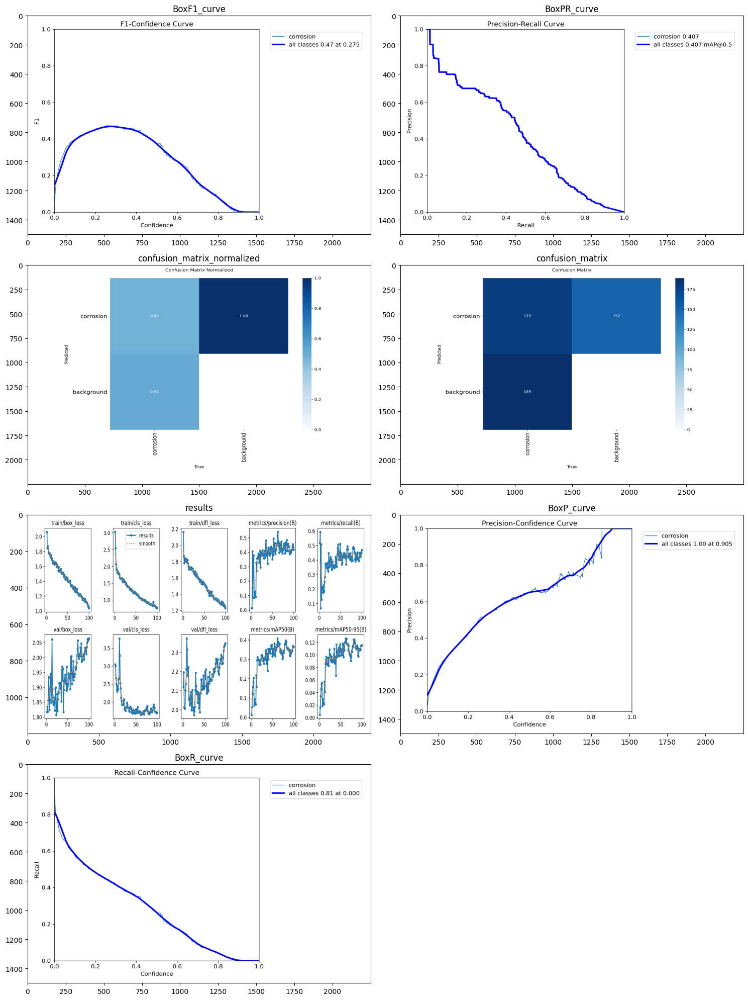

In [9]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'train/*.png'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

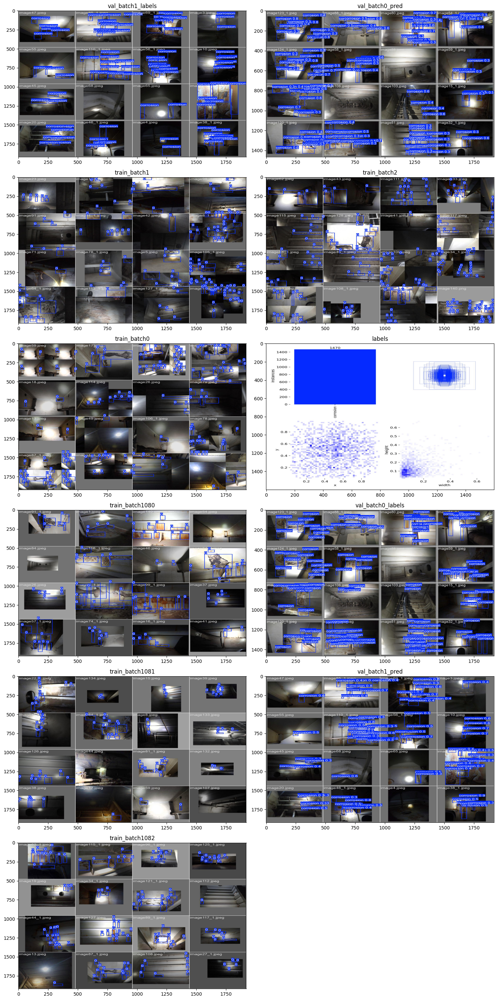

In [10]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'train/*.jpg'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()


In [11]:
# Avaliar o modelo
model.val(save_json=True, project=project, name="val")

Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
YOLO11n summary (fused): 100 layers, 2,582,347 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3598.2±1292.5 MB/s, size: 29.6 KB)
val: Scanning /home/luiz-fonseca/visao_computacional/dataset_yolo_final/labels/val.cache... 53 images, 2 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 53/53 274.8Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 8.1it/s 0.5s0.3s
                   all         53        367      0.516      0.431      0.408      0.127
Speed: 1.0ms preprocess, 2.5ms inference, 0.0ms loss, 0.3ms postprocess per image
Saving /home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11n/val/predictions.json...
Results saved to /home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11n/val


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a9e2bf56270>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

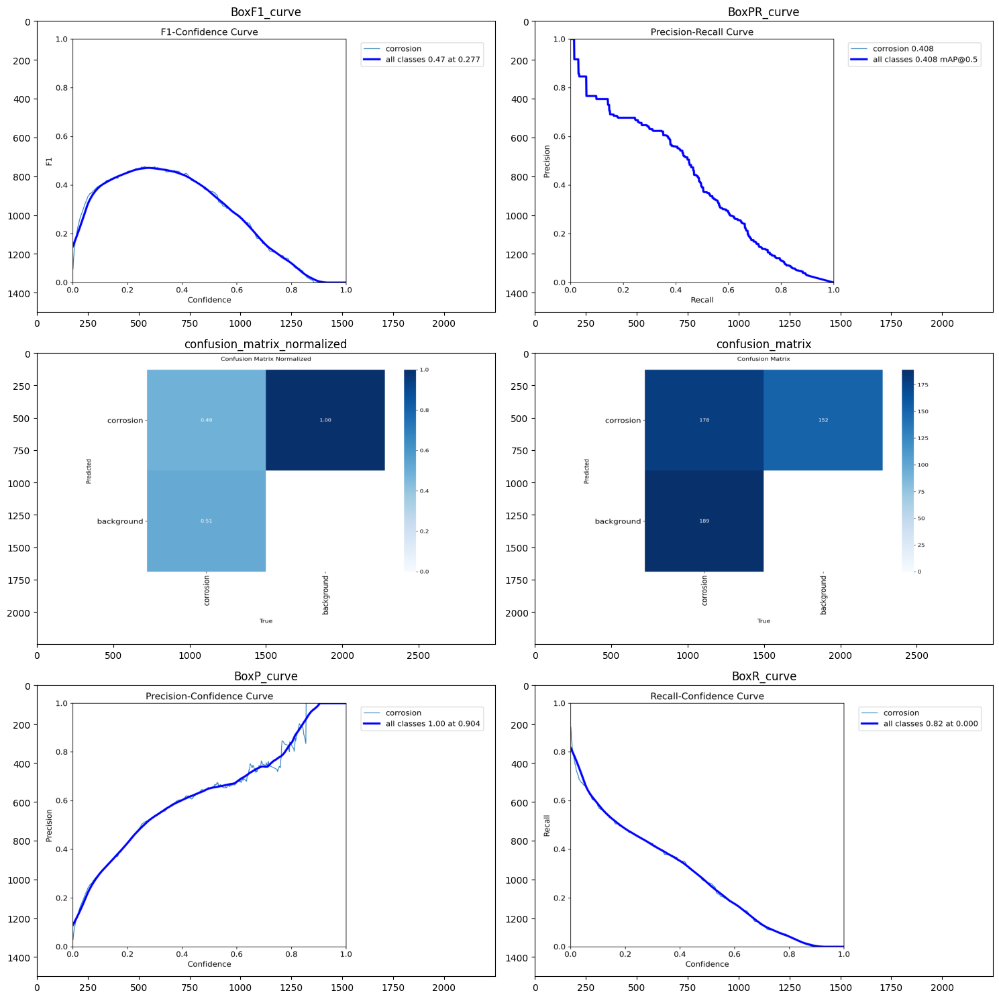

In [12]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'val/*.png'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

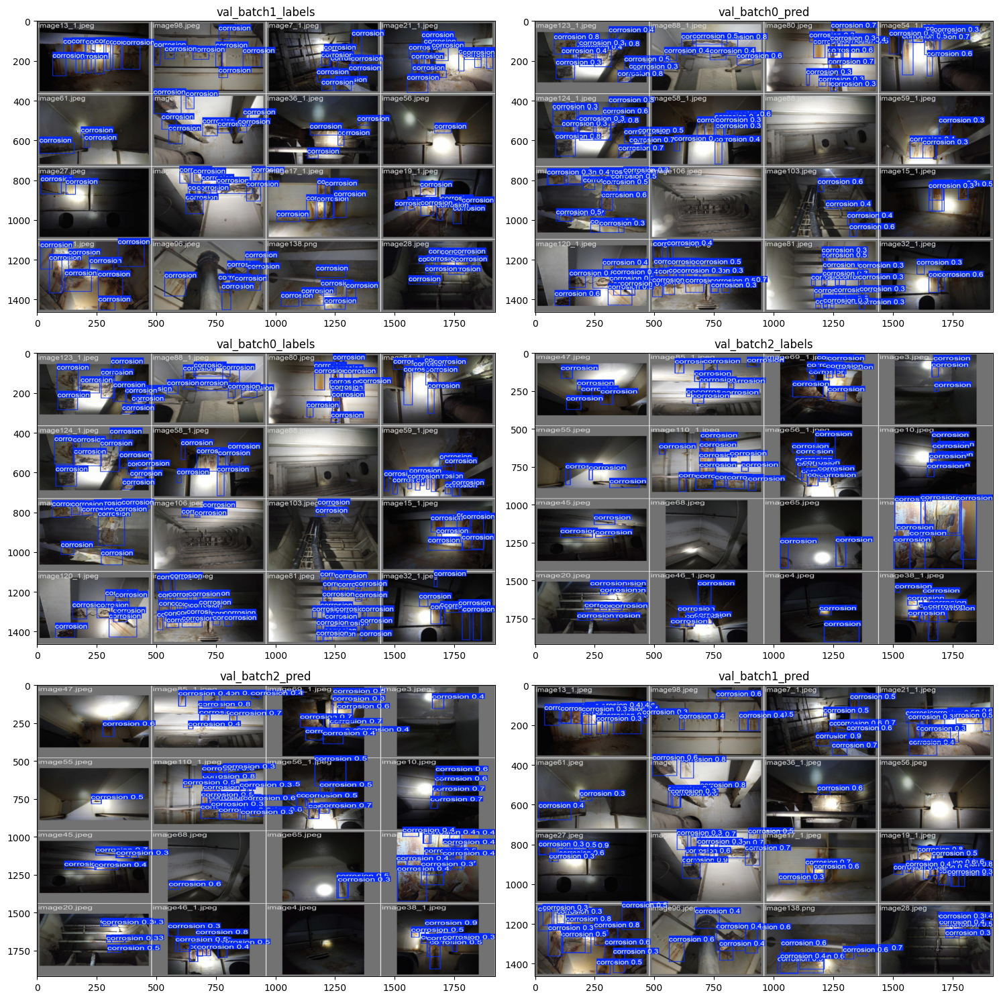

In [13]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'val/*.jpg'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

# YOLO Small

In [14]:
model_name = "yolo11s.pt"

# Carregar Modelo pre-treinado ou .yaml para treinar do zero
model = YOLO(model_name)  # Yolo 11 Pre-Treinado

project = os.path.join(SAVE_PATH, model_name[:-3])

model.tune(data=DATA_YAML, epochs=TUNE_EPOCH, imgsz=IM_SIZE, iterations=10, plots=False, save=False, val=True, project=os.path.join(project,"tunning"))

Tuner: Initialized Tuner instance with 'tune_dir=/home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11s/tunning/tune'
Tuner: 💡 Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/10 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'cutmix': 0.0, 'copy_paste': 0.0, 'close_mosaic': 10}
Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, cop

In [15]:
model = YOLO(model_name)  # Yolo 11 Pre-Treinado
# Ajuste o caminho abaixo para onde seu tune salvou o arquivo
path_to_params = os.path.join(project,'tunning/tune/best_hyperparameters.yaml')

with open(path_to_params, 'r') as f:
    best_params = yaml.safe_load(f)

# Removemos 'epochs' se existir (para não sobrescrever o treino final)
if 'epochs' in best_params:
    del best_params['epochs']

# Forçamos a conversão de float para int nos parâmetros que exigem inteiros
if 'close_mosaic' in best_params:
    best_params['close_mosaic'] = int(best_params['close_mosaic'])

# Dica extra: 'warmup_epochs' também costuma dar esse erro, vale prevenir
if 'warmup_epochs' in best_params:
    best_params['warmup_epochs'] = int(best_params['warmup_epochs'])


# Usamos **best_params para "desempacotar" os argumentos automaticamente
model.train(
    data=DATA_YAML,
    epochs=TRAIN_EPOCH,      # Defina aqui as épocas REAIS do treino final (ex: 100, 300)
    imgsz=IM_SIZE,       # Garanta que o tamanho da imagem seja o mesmo
    project=project,
    **best_params    # Aqui entram a lr0, momentum, etc. descobertos
)


Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.7016, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.37135, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset_yolo_final/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5297, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.70328, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.0184, hsv_s=0.85083, hsv_v=0.33398, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.00976, lrf=0.00971, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.93543, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, pat

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a9e3981e9e0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

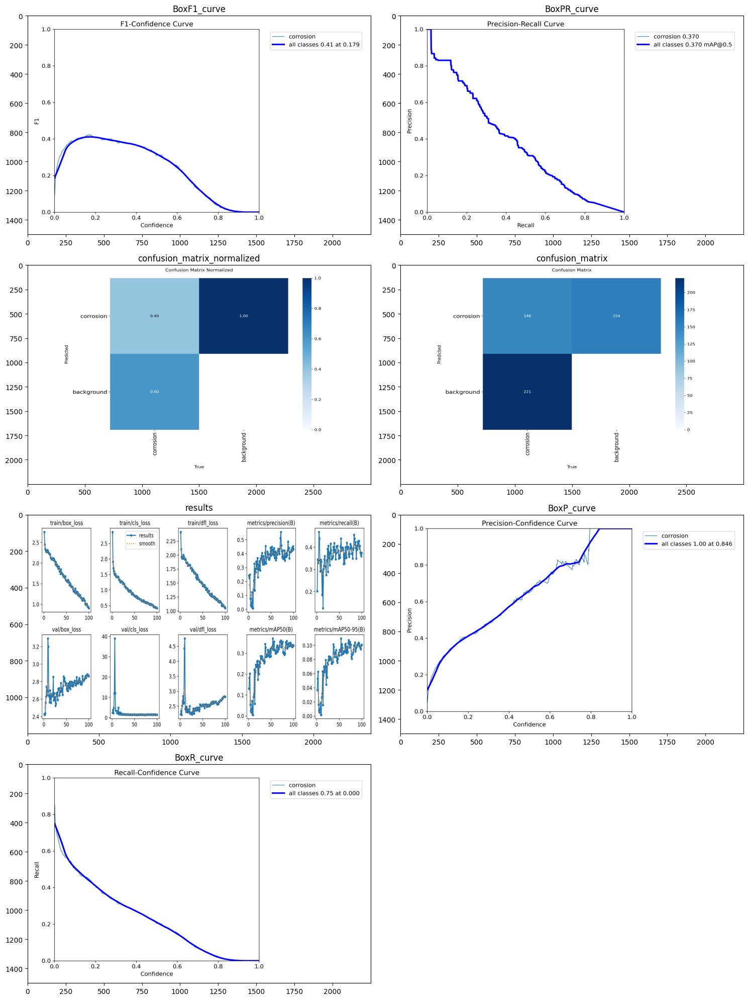

In [16]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'train/*.png'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

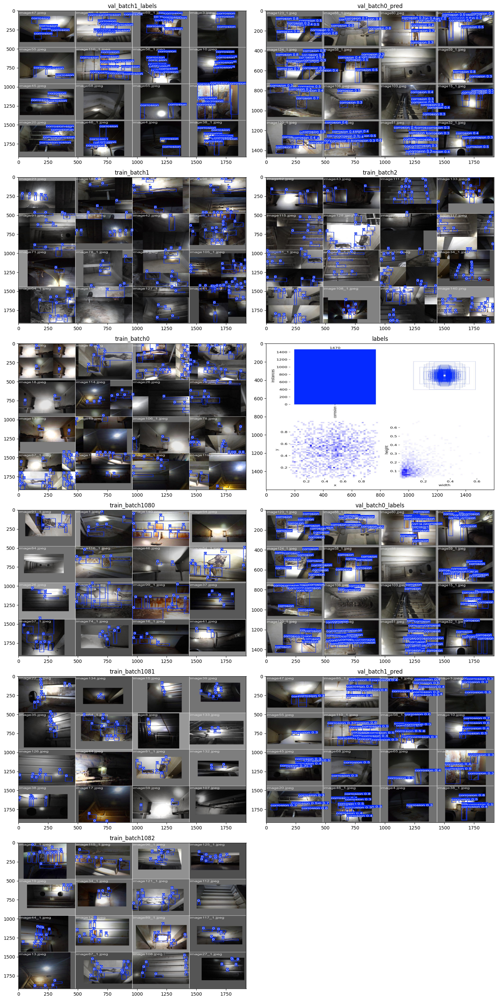

In [17]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'train/*.jpg'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()


In [18]:
# Avaliar o modelo
model.val(save_json=True, project=project, name="val")

Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
YOLO11s summary (fused): 100 layers, 9,413,187 parameters, 0 gradients, 21.3 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3642.9±1541.7 MB/s, size: 29.6 KB)
val: Scanning /home/luiz-fonseca/visao_computacional/dataset_yolo_final/labels/val.cache... 53 images, 2 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 53/53 519.4Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 8.1it/s 0.5s0.3s
                   all         53        367      0.406      0.439       0.37       0.11
Speed: 1.1ms preprocess, 2.6ms inference, 0.0ms loss, 1.9ms postprocess per image
Saving /home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11s/val/predictions.json...
Results saved to /home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11s/val


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a9e39d8ec10>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

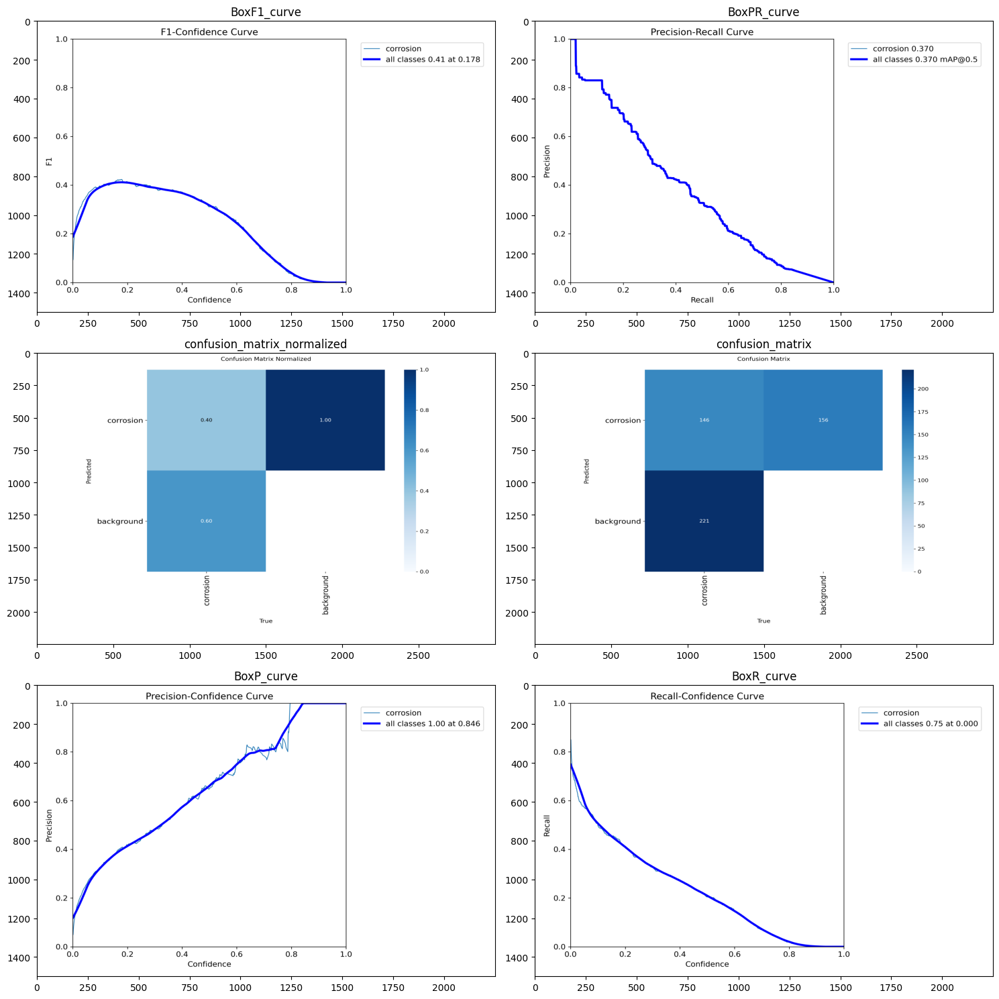

In [19]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'val/*.png'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

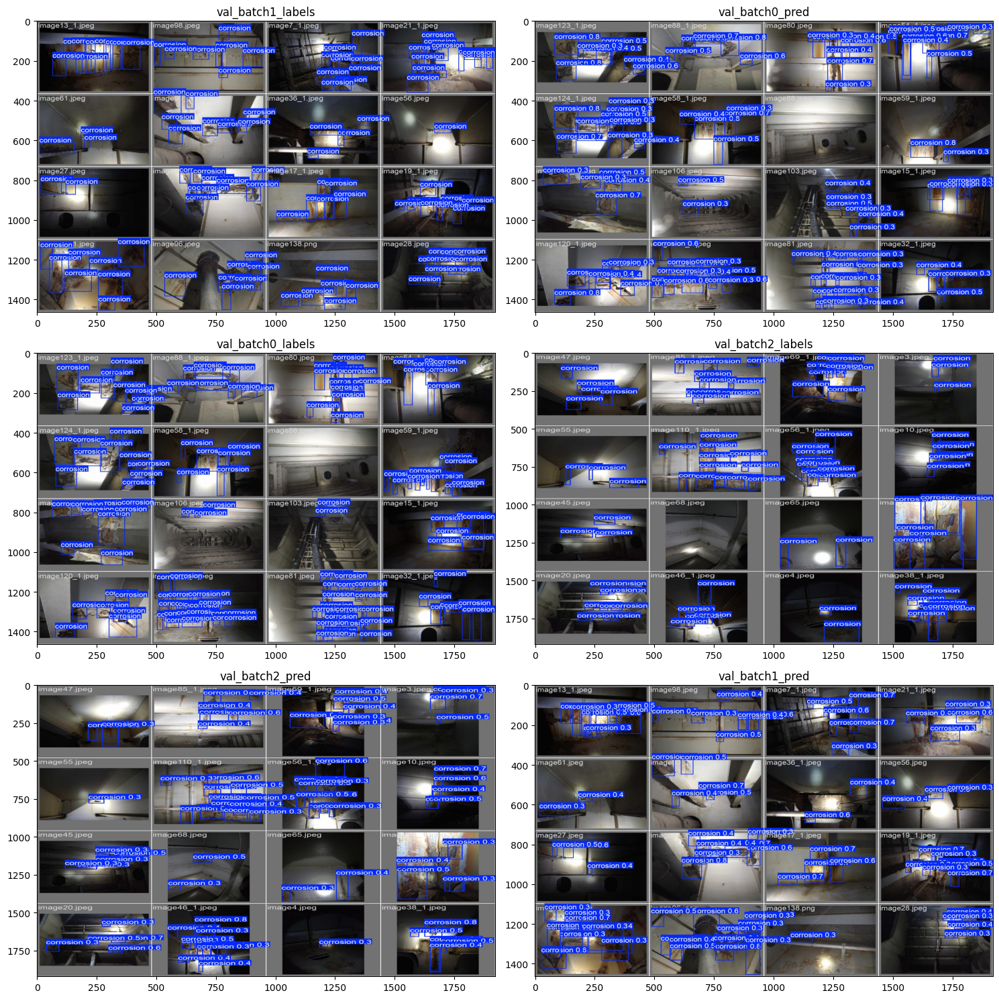

In [20]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'val/*.jpg'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

# YOLO Medium

In [21]:
model_name = "yolo11m.pt"

# Carregar Modelo pre-treinado ou .yaml para treinar do zero
model = YOLO(model_name)  # Yolo 11 Pre-Treinado

project = os.path.join(SAVE_PATH, model_name[:-3])

model.tune(data=DATA_YAML, epochs=TUNE_EPOCH, imgsz=IM_SIZE, iterations=10, plots=False, save=False, val=True, project=os.path.join(project,"tunning"))

Tuner: Initialized Tuner instance with 'tune_dir=/home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11m/tunning/tune'
Tuner: 💡 Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/10 with hyperparameters: {'lr0': 0.01, 'lrf': 0.01, 'momentum': 0.937, 'weight_decay': 0.0005, 'warmup_epochs': 3.0, 'warmup_momentum': 0.8, 'box': 7.5, 'cls': 0.5, 'dfl': 1.5, 'hsv_h': 0.015, 'hsv_s': 0.7, 'hsv_v': 0.4, 'degrees': 0.0, 'translate': 0.1, 'scale': 0.5, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'fliplr': 0.5, 'bgr': 0.0, 'mosaic': 1.0, 'mixup': 0.0, 'cutmix': 0.0, 'copy_paste': 0.0, 'close_mosaic': 10}
Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, cop

In [22]:
model = YOLO(model_name)  # Yolo 11 Pre-Treinado
# Ajuste o caminho abaixo para onde seu tune salvou o arquivo
path_to_params = os.path.join(project,'tunning/tune/best_hyperparameters.yaml')

with open(path_to_params, 'r') as f:
    best_params = yaml.safe_load(f)

# Removemos 'epochs' se existir (para não sobrescrever o treino final)
if 'epochs' in best_params:
    del best_params['epochs']

# Forçamos a conversão de float para int nos parâmetros que exigem inteiros
if 'close_mosaic' in best_params:
    best_params['close_mosaic'] = int(best_params['close_mosaic'])

# Dica extra: 'warmup_epochs' também costuma dar esse erro, vale prevenir
if 'warmup_epochs' in best_params:
    best_params['warmup_epochs'] = int(best_params['warmup_epochs'])


# Usamos **best_params para "desempacotar" os argumentos automaticamente
model.train(
    data=DATA_YAML,
    epochs=TRAIN_EPOCH,      # Defina aqui as épocas REAIS do treino final (ex: 100, 300)
    imgsz=IM_SIZE,       # Garanta que o tamanho da imagem seja o mesmo
    project=project,
    **best_params    # Aqui entram a lr0, momentum, etc. descobertos
)


Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=8.36866, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.59387, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=dataset_yolo_final/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.26763, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11m.pt, momentum=0.98, mosaic=0.95114, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, persp

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a9e3981ed60>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

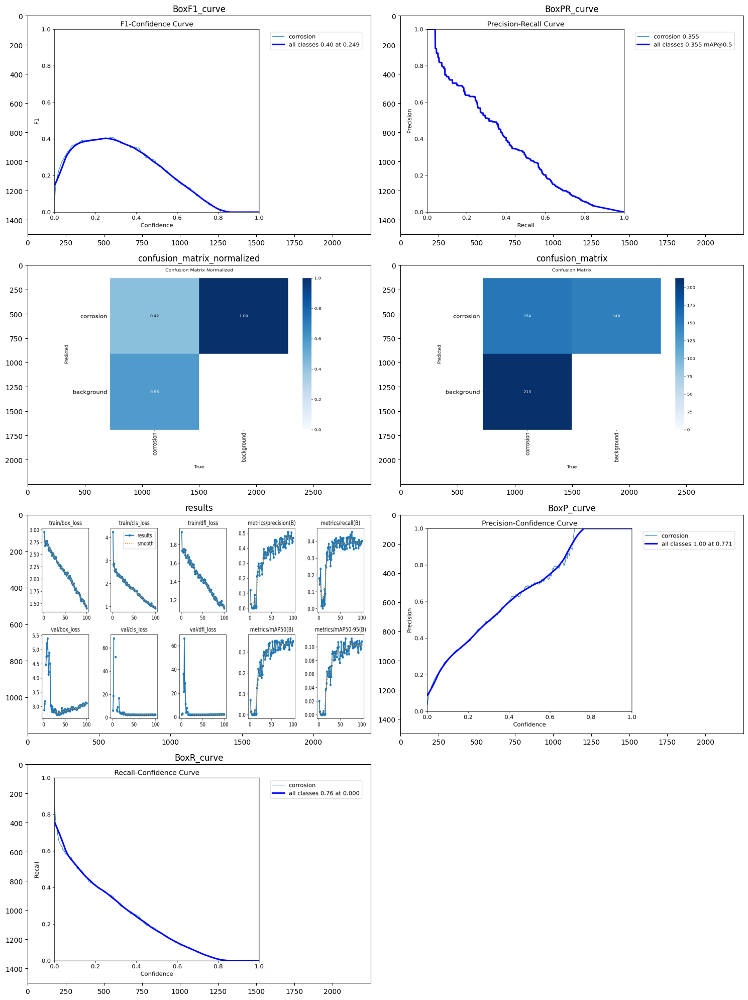

In [23]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'train/*.png'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

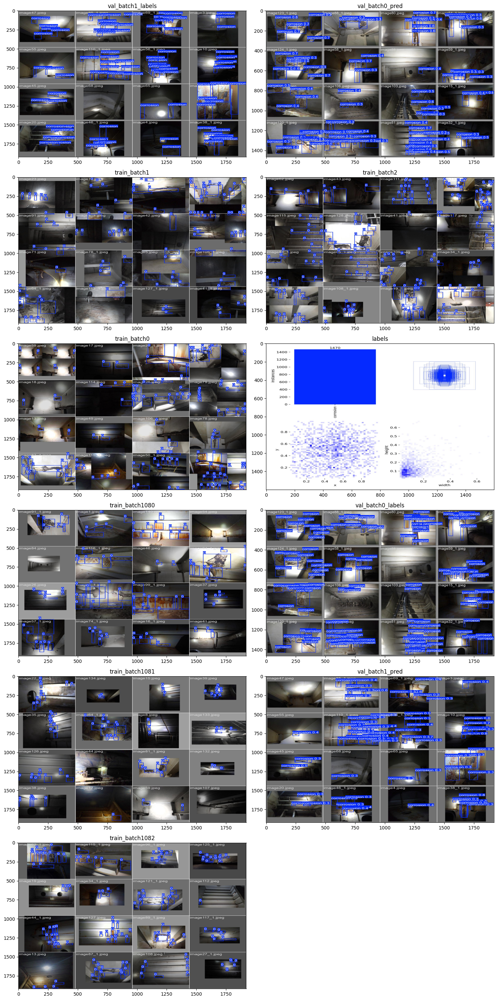

In [24]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'train/*.jpg'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()


In [25]:
# Avaliar o modelo
model.val(save_json=True, project=project, name="val")

Ultralytics 8.3.233 🚀 Python-3.13.5 torch-2.9.1+cu128 CUDA:0 (NVIDIA GeForce RTX 5080, 15842MiB)
YOLO11m summary (fused): 125 layers, 20,030,803 parameters, 0 gradients, 67.6 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3857.7±1206.3 MB/s, size: 29.6 KB)
val: Scanning /home/luiz-fonseca/visao_computacional/dataset_yolo_final/labels/val.cache... 53 images, 2 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 53/53 321.2Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 7.4it/s 0.5s0.2s
                   all         53        367      0.459      0.368      0.355      0.113
Speed: 1.1ms preprocess, 5.0ms inference, 0.0ms loss, 1.7ms postprocess per image
Saving /home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11m/val/predictions.json...
Results saved to /home/luiz-fonseca/visao_computacional/dataset_yolo_final/corrosion_detect_yolo/yolo11m/val


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7a9e12f3d2b0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

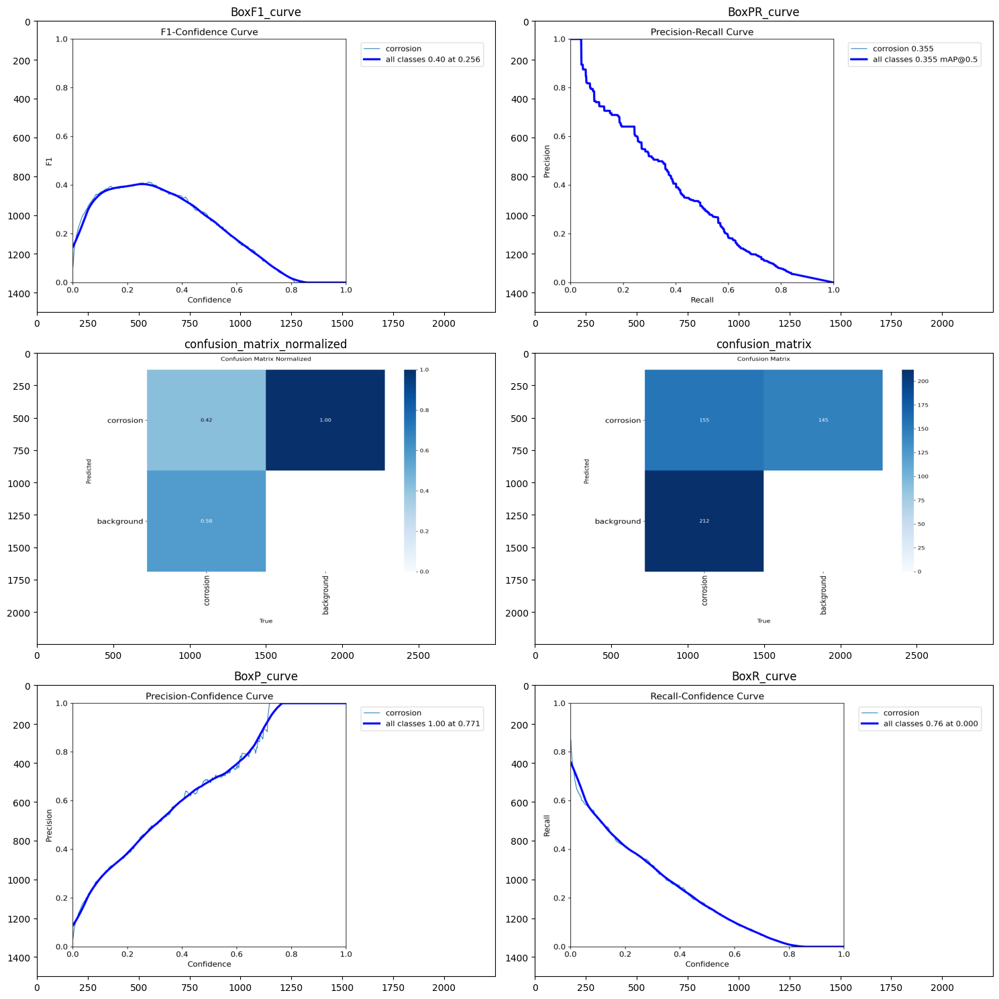

In [26]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'val/*.png'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

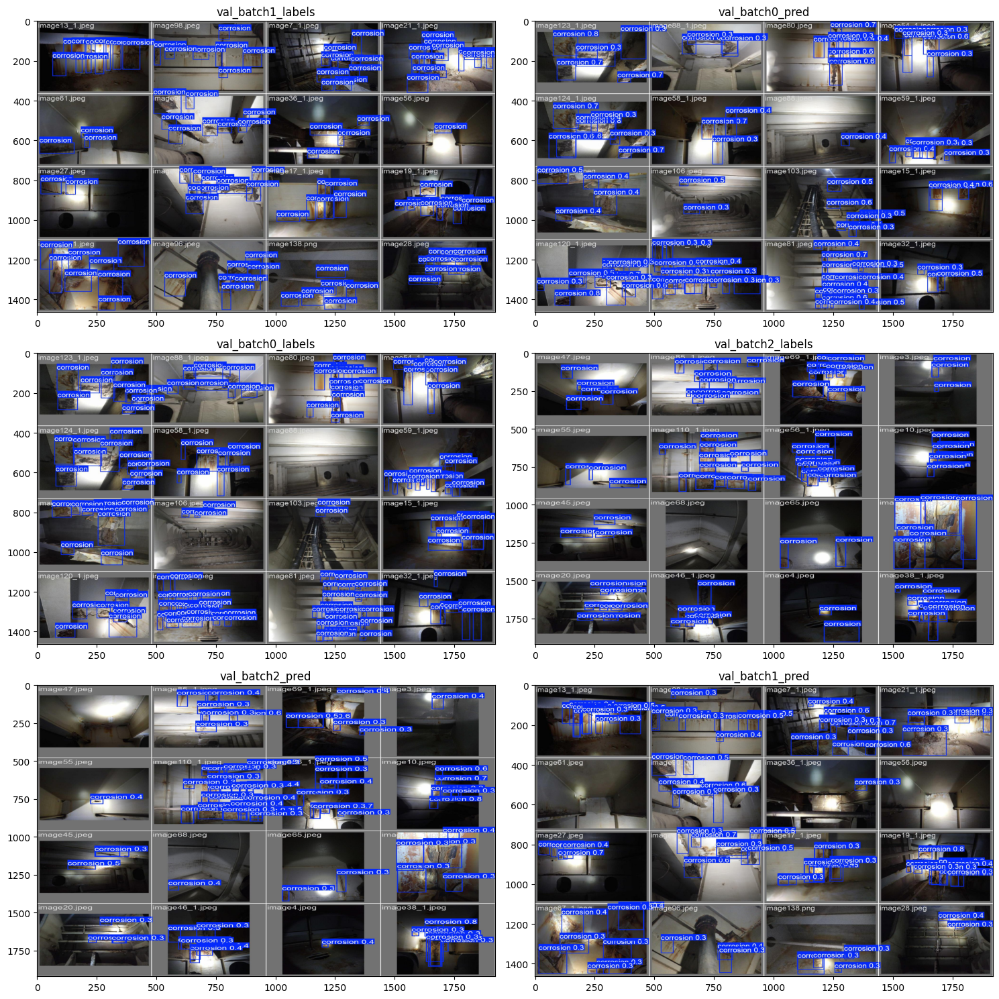

In [27]:
%matplotlib inline
import os
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker

metrics_img = glob(os.path.join(project, 'val/*.jpg'))
n_img = len(metrics_img)
n_cols = 2
n_rows = int(n_img / n_cols) + (1 if n_img % n_cols != 0 else 0)

fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 5))
axs = axs.flatten()

for i, ax in enumerate(axs):
    if i < n_img:
        img = plt.imread(metrics_img[i])
        ax.imshow(img, aspect='auto')
        ax.set_title(label=metrics_img[i].split('/')[-1].split('.')[0])
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

# Test

## YOLO Nano

In [30]:
model_name = "yolo11n"

model = YOLO(f"dataset_yolo_final/corrosion_detect_yolo/{model_name}/train/weights/best.pt")

project = os.path.join(SAVE_PATH, model_name)

model.predict("dataset_yolo_final/images/test/*.jpeg", save=True, conf=0.5, project=project, name="predictions")


image 1/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image100_1.jpeg: 576x640 11 corrosions, 12.1ms
image 2/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image102_1.jpeg: 480x640 10 corrosions, 11.4ms
image 3/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image10_1.jpeg: 512x640 3 corrosions, 11.3ms
image 4/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image118_1.jpeg: 416x640 (no detections), 11.3ms
image 5/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image12_1.jpeg: 480x640 4 corrosions, 2.1ms
image 6/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image130.jpeg: 480x640 3 corrosions, 1.7ms
image 7/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image131.jpeg: 416x640 1 corrosion, 1.9ms
image 8/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image29_1.jpeg: 480x640 (no detect

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'corrosion'}
 obb: None
 orig_img: array([[[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 18,  13,  15],
         [ 18,  13,  15],
         [ 18,  13,  15]],
 
        [[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 20,  15,  17],
         [ 20,  15,  17],
         [ 20,  15,  17]],
 
        [[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 22,  17,  19],
         [ 22,  17,  19],
         [ 22,  17,  19]],
 
        ...,
 
        [[133, 134, 144],
         [131, 134, 142],
         [127, 132, 141],
         ...,
         [146, 155, 152],
         [147, 155, 154],
         [147, 156, 153]],
 
        [[125, 127, 135],
         [122, 124, 132],
         [118, 121, 129],
         ...,
         [138, 

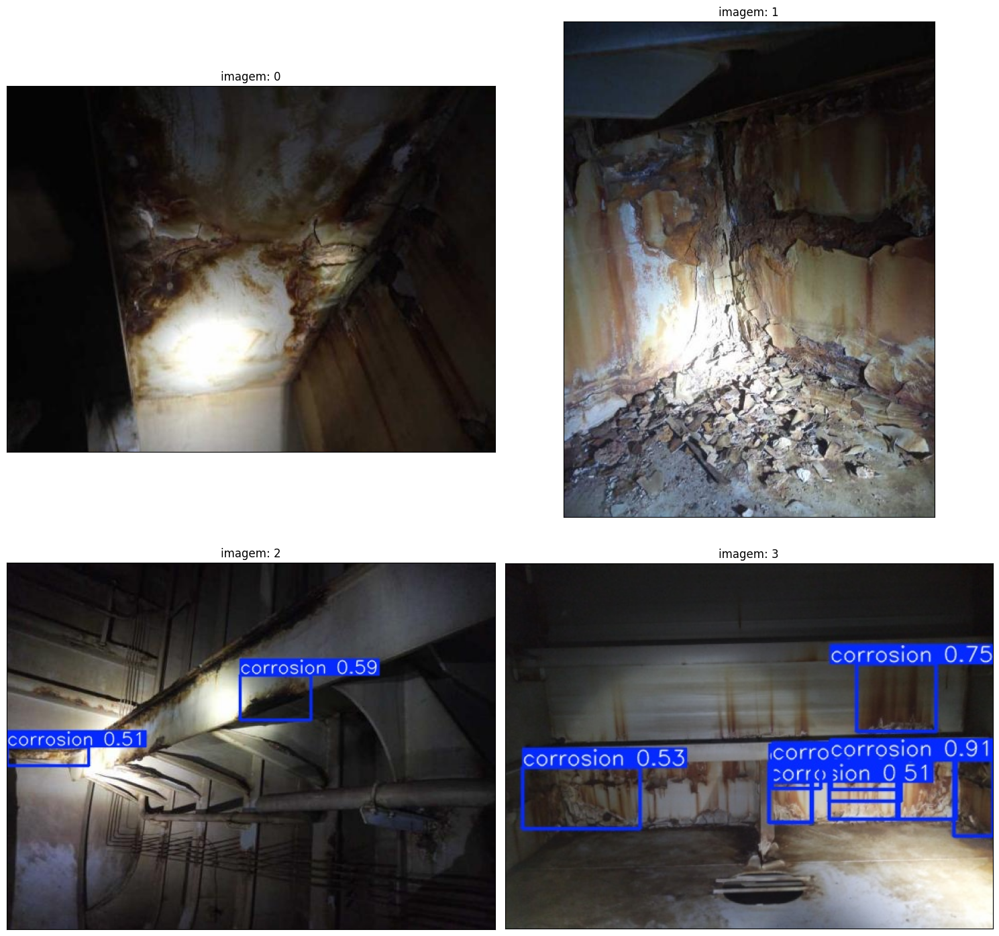

In [32]:
%matplotlib inline
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker
import random

num_samples = 4 # numero de imagens para visualizar.
all_dets = glob(os.path.join(project, "predictions/*.jpg"))
n_cols = 2
n_rows = int(num_samples / n_cols) + (1 if num_samples % n_cols != 0 else 0)
_, axs = plt.subplots(n_rows, n_cols, figsize=(15, 15))
axs = axs.flatten()
for i, (m, ax) in enumerate(zip(random.sample(all_dets, num_samples), axs)):
    if i < n_img:
        img = plt.imread(m)
        ax.imshow(img)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.yaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(label=f'imagem: {i}')
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

## YOLO Small

In [33]:
model_name = "yolo11s"

model = YOLO(f"dataset_yolo_final/corrosion_detect_yolo/{model_name}/train/weights/best.pt")

project = os.path.join(SAVE_PATH, model_name)

model.predict("dataset_yolo_final/images/test/*.jpeg", save=True, conf=0.5, project=project, name="predictions")


image 1/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image100_1.jpeg: 576x640 12 corrosions, 9.9ms
image 2/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image102_1.jpeg: 480x640 6 corrosions, 9.4ms
image 3/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image10_1.jpeg: 512x640 3 corrosions, 9.3ms
image 4/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image118_1.jpeg: 416x640 (no detections), 9.3ms
image 5/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image12_1.jpeg: 480x640 3 corrosions, 2.3ms
image 6/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image130.jpeg: 480x640 3 corrosions, 2.2ms
image 7/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image131.jpeg: 416x640 2 corrosions, 2.3ms
image 8/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image29_1.jpeg: 480x640 1 corrosion, 2

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'corrosion'}
 obb: None
 orig_img: array([[[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 18,  13,  15],
         [ 18,  13,  15],
         [ 18,  13,  15]],
 
        [[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 20,  15,  17],
         [ 20,  15,  17],
         [ 20,  15,  17]],
 
        [[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 22,  17,  19],
         [ 22,  17,  19],
         [ 22,  17,  19]],
 
        ...,
 
        [[133, 134, 144],
         [131, 134, 142],
         [127, 132, 141],
         ...,
         [146, 155, 152],
         [147, 155, 154],
         [147, 156, 153]],
 
        [[125, 127, 135],
         [122, 124, 132],
         [118, 121, 129],
         ...,
         [138, 

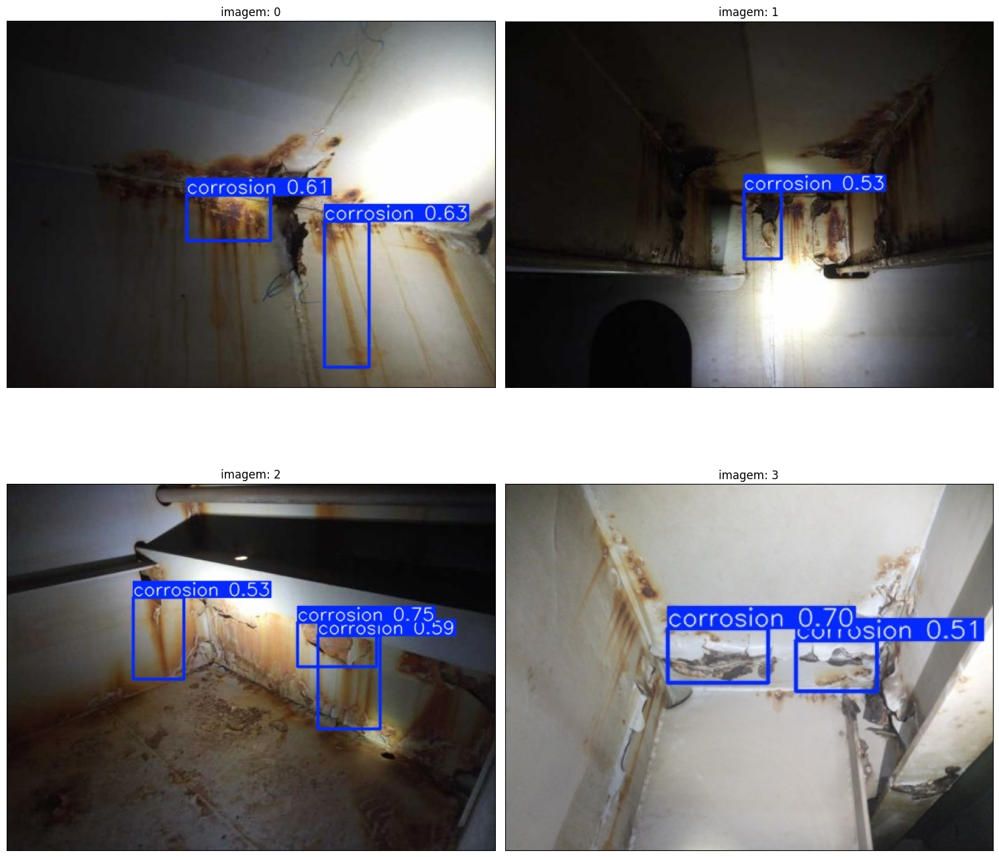

In [34]:
%matplotlib inline
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker
import random

num_samples = 4 # numero de imagens para visualizar.
all_dets = glob(os.path.join(project, "predictions/*.jpg"))
n_cols = 2
n_rows = int(num_samples / n_cols) + (1 if num_samples % n_cols != 0 else 0)
_, axs = plt.subplots(n_rows, n_cols, figsize=(15, 15))
axs = axs.flatten()
for i, (m, ax) in enumerate(zip(random.sample(all_dets, num_samples), axs)):
    if i < n_img:
        img = plt.imread(m)
        ax.imshow(img)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.yaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(label=f'imagem: {i}')
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()

## YOLO Medium

In [35]:
model_name = "yolo11m"

model = YOLO(f"dataset_yolo_final/corrosion_detect_yolo/{model_name}/train/weights/best.pt")

project = os.path.join(SAVE_PATH, model_name)

model.predict("dataset_yolo_final/images/test/*.jpeg", save=True, conf=0.5, project=project, name="predictions")


image 1/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image100_1.jpeg: 576x640 6 corrosions, 8.4ms
image 2/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image102_1.jpeg: 480x640 8 corrosions, 8.0ms
image 3/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image10_1.jpeg: 512x640 1 corrosion, 8.0ms
image 4/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image118_1.jpeg: 416x640 (no detections), 7.9ms
image 5/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image12_1.jpeg: 480x640 4 corrosions, 3.8ms
image 6/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image130.jpeg: 480x640 (no detections), 3.7ms
image 7/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image131.jpeg: 416x640 (no detections), 3.7ms
image 8/28 /home/luiz-fonseca/visao_computacional/dataset_yolo_final/images/test/image29_1.jpeg: 480x640 2 corrosio

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'corrosion'}
 obb: None
 orig_img: array([[[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 18,  13,  15],
         [ 18,  13,  15],
         [ 18,  13,  15]],
 
        [[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 20,  15,  17],
         [ 20,  15,  17],
         [ 20,  15,  17]],
 
        [[ 56,  52,  51],
         [ 56,  52,  51],
         [ 56,  52,  51],
         ...,
         [ 22,  17,  19],
         [ 22,  17,  19],
         [ 22,  17,  19]],
 
        ...,
 
        [[133, 134, 144],
         [131, 134, 142],
         [127, 132, 141],
         ...,
         [146, 155, 152],
         [147, 155, 154],
         [147, 156, 153]],
 
        [[125, 127, 135],
         [122, 124, 132],
         [118, 121, 129],
         ...,
         [138, 

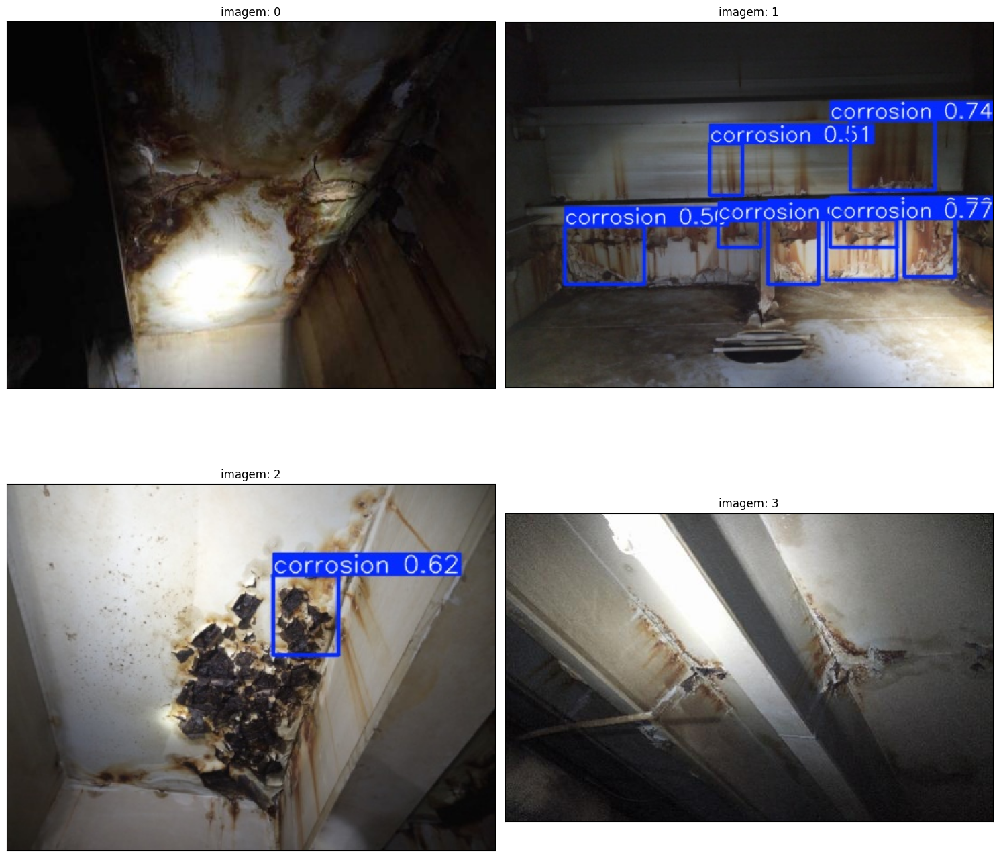

In [37]:
%matplotlib inline
import matplotlib.pyplot as plt
from glob import glob
import matplotlib.ticker as ticker
import random

num_samples = 4 # numero de imagens para visualizar.
all_dets = glob(os.path.join(project, "predictions/*.jpg"))
n_cols = 2
n_rows = int(num_samples / n_cols) + (1 if num_samples % n_cols != 0 else 0)
_, axs = plt.subplots(n_rows, n_cols, figsize=(15, 15))
axs = axs.flatten()
for i, (m, ax) in enumerate(zip(random.sample(all_dets, num_samples), axs)):
    if i < n_img:
        img = plt.imread(m)
        ax.imshow(img)
        ax.xaxis.set_major_locator(ticker.NullLocator())
        ax.yaxis.set_major_locator(ticker.NullLocator())
        ax.set_title(label=f'imagem: {i}')
        ax.axis('on')
    else:
        ax.axis('off')

plt.tight_layout()
plt.show()